# Deep Learning Based Fake Face Generation and Detection - TeamA
### Capstone 5인이상집합금지

In [1]:
from __future__ import print_function
import argparse
import os
import random
import numpy as np
import tqdm
import cv2

import torch
import torch.nn as nn
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torchvision.utils import save_image

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.pyplot import imshow, imsave
%matplotlib inline
from IPython.display import HTML

print("Random Seed: ", 999)
random.seed(999)
torch.manual_seed(999)

Random Seed:  999


In [2]:
# check if CUDA is available
train_on_gpu = torch.cuda.is_available()
#train_on_gpu = False

if not train_on_gpu:
    device = 'cpu'
    print('CUDA is not available.  Training on CPU ...')
else:
    device = 'cuda'
    print('CUDA is available!  Training on GPU ...')

CUDA is available!  Training on GPU ...


## Hyper parameter

In [3]:
dataroot = "data/images"

# Num_workers
workers = 2

# 배치 사이즈
batch_size = 64

# 학습이미지 사이즈, transform을 통해 모든 이미지를 64로 조정
image_size = 64

# 교육 이미지의 채널 수입니다.
nc = 3

# z 잠재 벡터의 크기(즉, 제너레이터 입력의 크기)
nz = 100

# 생성기의 피쳐 맵 크기
ngf = 25

# 판별기의 피쳐 맵 크기
ndf = 25

num_epochs = 20

# Learning rate
lr = 0.0004

# Adam Optimizer에 대한 베타1 하이퍼 파라미터
beta1 = 0.3

## DataLoader

In [4]:
# 데이터셋 가져오기
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

## Training Image

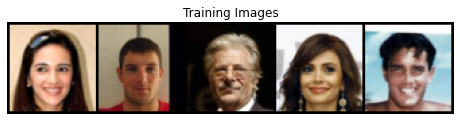

In [5]:
# Training image 확인
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
for i in range(1, 6):
    plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:i], padding=2, normalize=True).cpu(),(1,2,0)))

In [6]:
# Tensor에서 이미지로 변환하는 함수
def tensor2img(tensor):
    img = (np.transpose(tensor.detach().cpu().numpy(), [1,2,0])+1)/2.
    return img

In [7]:
# 100개의 샘플 이미지 가져오기
def get_sample_image(G, n_noise=100, n_samples=64):

    n_rows = int(np.sqrt(n_samples))
    z = (torch.rand(size=[n_samples, n_noise])*2-1).to(device) # U[-1, 1]
    x_fake = G(z)
    x_fake = torch.cat([torch.cat([x_fake[n_rows*j+i] for i in range(n_rows)], dim=1) for j in range(n_rows)], dim=2)
    result = tensor2img(x_fake)
    return result

In [8]:
# netG 및 netD에서 호출되는 사용자 지정 가중치 초기화
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        # input tensor을 N(mean, std^2)의 normal distribution(정규분포)에 따라 초기화
        nn.init.normal_(m.weight.data, 0.0, 0.02) 
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        # torch.nn.init.constant_(tensor, val)
        nn.init.constant_(m.bias.data, 0)

## Generator

In [9]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            # 미니배치 마다 normalization
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# Create the generator
netG = Generator()

netG.to(device)

# initialize all weights (mean=0, stdev=0.2)
netG.apply(weights_init)

# model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 200, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(200, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(200, 100, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(100, 50, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(50, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(50, 25, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(25, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(25, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## Discriminator

In [11]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [12]:
# Create the Discriminator
netD = Discriminator()

netD.to(device)

# initialize all weights (mean=0, stdev=0.2)
netD.apply(weights_init)

# model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 25, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(25, 50, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(50, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(50, 100, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(100, 200, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(200, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(200, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Loss Function / Optimizer

In [13]:
# Loss Function
criterion = nn.BCELoss()

# visualize noise
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# label
real_label = 1.
fake_label = 0.

# optimizer
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Training

In [14]:
img_list = []
img_list2 = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        
        # 모든 가짜를 배치단위로 훈련
        
        #gradient초기화
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        # backward pass
        errD_real.backward()
        D_x = output.mean().item()

        # 모든 가짜를 배치단위로 훈련
        
        # noise생성
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        # Update Generator
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        if i % 200 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch+1, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # 이미지 생성과정 확인 및 저장
        if (iters % 400 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        if epoch == 19:
            vutils.save_image(fake[1], './gan_data/fake/fake%03d.png' %(i), normalize=True)
        iters += 1

Starting Training Loop...
[1/20][0/822]	Loss_D: 1.3099	Loss_G: 2.5705	D(x): 0.4683	D(G(z)): 0.3702 / 0.0962
[1/20][200/822]	Loss_D: 0.4304	Loss_G: 2.9311	D(x): 0.7836	D(G(z)): 0.1493 / 0.0666
[1/20][400/822]	Loss_D: 1.3892	Loss_G: 4.3218	D(x): 0.8572	D(G(z)): 0.6452 / 0.0198
[1/20][600/822]	Loss_D: 0.6814	Loss_G: 2.6229	D(x): 0.7500	D(G(z)): 0.2773 / 0.0956
[1/20][800/822]	Loss_D: 0.9759	Loss_G: 4.0924	D(x): 0.8160	D(G(z)): 0.4719 / 0.0252
[2/20][0/822]	Loss_D: 0.9307	Loss_G: 1.2716	D(x): 0.4808	D(G(z)): 0.0689 / 0.3455
[2/20][200/822]	Loss_D: 0.7840	Loss_G: 1.8349	D(x): 0.5744	D(G(z)): 0.1118 / 0.1941
[2/20][400/822]	Loss_D: 0.7996	Loss_G: 3.5819	D(x): 0.8894	D(G(z)): 0.4625 / 0.0390
[2/20][600/822]	Loss_D: 1.1476	Loss_G: 1.1642	D(x): 0.4116	D(G(z)): 0.0688 / 0.3709
[2/20][800/822]	Loss_D: 0.7504	Loss_G: 1.6691	D(x): 0.5978	D(G(z)): 0.1368 / 0.2225
[3/20][0/822]	Loss_D: 1.7999	Loss_G: 0.6540	D(x): 0.2298	D(G(z)): 0.0238 / 0.5548
[3/20][200/822]	Loss_D: 1.0023	Loss_G: 3.7274	D(x): 0.88

## Model Training Loss

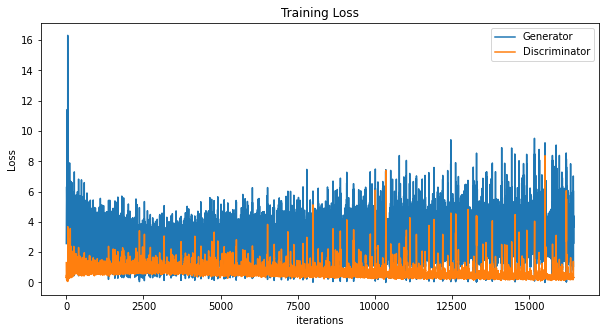

In [15]:
plt.figure(figsize=(10,5))
plt.title("Training Loss")
plt.plot(G_losses,label="Generator")
plt.plot(D_losses,label="Discriminator")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [16]:
#제너레이터가 학습을 하면 할수록 판별자의 loss가 올라간다. 
#판별자가 생성자에 비해 성능이 좋으므로 loss가 올라간다ㅣ.

Animation size has reached 21052544 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


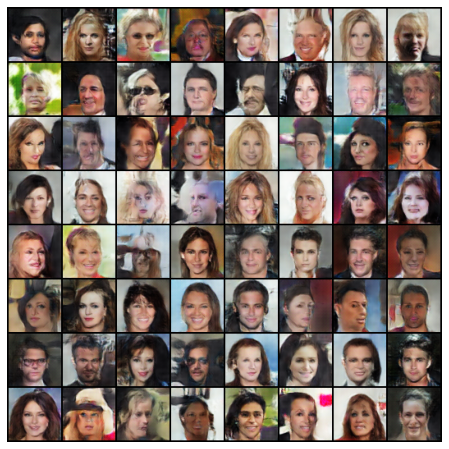

In [17]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

## Visualize Fake Image

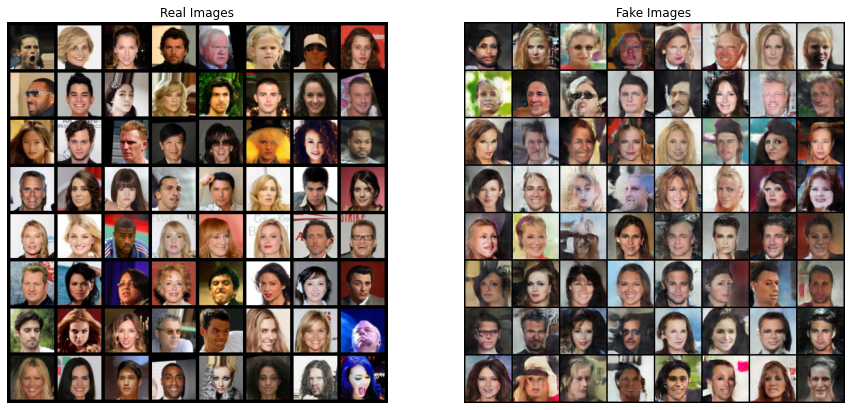

In [18]:
real_batch = next(iter(dataloader))

#plot
# real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# last epoch fake images
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()